# **FASE 1: Entendimiento del Negocio**

El Ministerio de Transporte de la república de Colombia está realizando un estudio para entender el comportamiento de los habitantes de la ciudad de Bogotá en las vías del país, esto con el fin de tomar las acciones necesarias en búsqueda de la concientización de la ciudadanía. Dentro de estas acciones que se pretende realizar una vez terminado el estudio están: Jornadas de capacitacion y concientización a conductores, verificacion de señalizaciones de transito, entre otras. 

Para realizar este estudio, el ministerio cuenta con un conjunto de datos de accidentalidad, registrado desde el año 2015 hasta el 2019.

### **1. Objetivo del negocio y situación actual**

#### **1.1 Objetivos del negocio**
    
   * Comprender las caracteristicas de peso, que hacen que un accidente en la ciudad de Bogotá sea letal para los ciudadanos.

#### **1.2 Situación actual** 

La situación actual en cuanto accidentalidad es grave, pues en los ultimos meses se ha dado un incremento considerable de accidentes de tránsito. Por otro lado, actualmente existen unos datos registrados de accidentes desde el año 2015, sin embargo nunca se han estudiado ni se les ha dado un uso provechoso.

### **2. Objetivos del proyecto**


1. Predecir la gravedad de un accidente antes de que este ocurra con base en las caracterisitcas del mismo (sexo, edad, localidad, dieseño del lugar, entre otras)

2. Entender los aspectos cruciales que debe tener un accidente para considerarse letal.

### **3. Planeación del proyecto**
Este proyecto de machine learning seguirá la metodología CRISP, el cual nos permite de manera organizada llevar a cabo una serie de fases iterativas, con el fin de tener un resultado satisfactorio al final del estudio. A continuación, se detallan las fases que se van a desarrollar en el proyecto.

#### **1. Fase de Entendimiento de los datos** 

En esta fase vamos a centrarnos en obtener los conjuntos de datos proprcionados por el ministerio, acá vamos a tener en cuenta aspectos como el formato, espacio en memoria y homogeneidad de los datos. Otra activdad importante dentro de la presente fase, es realizar análisis exploratorios sobre los datos, obteniendo información valiosa por medio de la estadística descriptiva y visualización de datos estadísticos.


#### **2. Fase de Preparación de los datos**

Acá vamos a realizar una selección de los atributos que nos interesan en este estudio, verificaremos los tipos de datos y caracterizaremos la información con la que vamos a trabajar. De igual manera, realizaremos una limpieza de datos con el fin de obviar o eliminar algunos valores _outliers_ que puedan darnos problemas en nuestros resultados.

#### **3. Fase de Modelamiento**

En esta fase es donde vamos a seleccionar el modelo más adecuado para abordar el problema, tambien es donde expermientamos con los diferentes hiperparametros y finalmente construimos y entrenamos el mejor modelo posible que resuelva el problema.

#### **4. Evaluacion**

En esta fase establecemos los criterios que se tendrán en cuenta para evaluar cuan bueno es el modelo que hemos construido, posteriormente analizamos los resultados obtenidos de modo que podamos obtener información útil para la solución del problema.

**Nota:** _Los datos usados para el proyecto están disponibles haciendo clic [aquí](https://datosabiertos.bogota.gov.co/dataset/siniestros-viales-consolidados-bogota-d-c/resource/9e3add8e-3f46-42ce-9c0f-419964f6f598)_

# **FASE 2: Entendimiento de los datos**

Para este proyecto se usará el conjunto de datos de _**Siniestros Viales de la ciudad de Bogotá**_, el cual tiene registrado la información de accidentes desde el año 2015 hasta el año 2019.

El formato de la fuente de los datos es Excel, el cual cuenta con 4 hojas, las cuales son:

* **SINIESTROS**: En esta hoja encontramos la información propia de los accidentes de transito (e.g Tipo de accidente, Fecha, Localidad, entre otros)

* **ACTOR VIAL**: En esta hoja se encuentra la información de las personas implicadas en el accidente (e.g. Sexo, Edad, Estado de la persona), varias personas pueden verse implicada en un mismo accidente.

* **VEHICULOS**: En esta hoja se encuentra la información relacionada a los vehiculos implicados en el accidente de transito (e.g Si el vehiculo es un carro, una moto o un bus. Si el vehiculo se fugó del lugar del accidente o no, entre otros)

* **HIPOTESIS**: Por último, en esta hoja se encuentran registradas algunas posibles causas del accidente, como por ejemplo, el no respetar un semaforo en rojo, el exceso de velocidad o el desobedecer alguna señal de tránsito.

Para el presente estudio, se usarán las primeras 3 hojas, las cuales nos ofrecen los datos necesarios para el cumplimiento de los objetivos. Dado que este estudio no busca dar algun motivo por el cual un accidente ocurrió, no se ve necesario el uso de los datos presentes en la hoja **HIPOTESIS**.

### Importacion de Liberías

In [ ]:
!pip install seaborn --upgrade

Requirement already up-to-date: seaborn in /usr/local/lib/python3.6/dist-packages (0.11.0)


In [ ]:
# Importacion de librerias basicas
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm

# Encoders
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

# Particiones de prueba y entrenamiento
from sklearn.model_selection import train_test_split

# Modelos
from sklearn.tree import DecisionTreeClassifier

#Visualización de árboles de decisión
from sklearn.tree import export_graphviz

# Visualizacion matriz de confusion
from sklearn.metrics import confusion_matrix

In [ ]:
#Librerías de visualización de grafos

# https://pypi.python.org/pypi/pydot
!apt install graphviz
!pip install graphviz
!pip install pydot

#Visualización de grafos con graphviz
import graphviz 
import pydot

Reading package lists... Done
Building dependency tree       
Reading state information... Done
graphviz is already the newest version (2.40.1-2).
0 upgraded, 0 newly installed, 0 to remove and 11 not upgraded.


In [ ]:
plt.style.use('ggplot')

## **Funciones auxiliares de graficas** ...

In [ ]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    Esta funcion pinta una matriz de confusión y realiza una normalizacion de los datos
    de la matriz, si es el caso
    """
    import itertools
    if normalize:
        cm = (cm.astype('float') / cm.sum(axis=1)[:, np.newaxis])*100
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '{percent:.2f}%' if normalize else '{percent:d}'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, fmt.format(percent=cm[i, j]),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('Categorías verdaderas')
    plt.xlabel('Categorias predichas')
    plt.grid(False)
    plt.tight_layout()

## **1. Adquisión e Integracion de los datos**
Primero realizamos la adquisión de los datos, para el presente estudio, se tendrán en cuenta las tres primeras hojas: **'SINIESTROS'**, **'ACTORES'** y **'VEHICULOS'**.

Vamos entonces a guardar en la variables `df_siniestros` un dataframe con los datos de los accidentes, en la variable `df_actores` un dataframe con los datos de las personas y en `df_vehiculos` un dataframe con los datos de los vehiuclos implicados.

In [ ]:
df_siniestros = pd.read_excel('accidentalidad_bogota.xlsx', sheet_name='SINIESTROS')
df_actores = pd.read_excel('accidentalidad_bogota.xlsx', sheet_name='ACTOR_VIAL')
#df_vehiculos = pd.read_excel(io.BytesIO(uploaded['accidentalidad_bogota.xlsx']), sheet_name='VEHICULOS')

## **2. Análisis exploratorio de los datos**
Ahora vamos a explorar cada uno de los dataframes que hemos almacenado en la etapa de Adquisión de los datos:


### **Dataframe `df_siniestros`**

  Primero damos un vistazo inicial a estos datos, para conocer los nombres de las columnas, sus tipos de datos, su peso en memoria, la cantidad de filas y valores nulos:


In [ ]:
df_siniestros.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 173443 entries, 0 to 173442
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   CODIGO_SINIESTRO  173443 non-null  int64 
 1   FECHA             173443 non-null  object
 2   HORA              173443 non-null  object
 3   GRAVEDAD          173443 non-null  object
 4   CLASE             173443 non-null  object
 5   CHOQUE_CON        147737 non-null  object
 6   OBJETO_FIJO       5514 non-null    object
 7   DIRECCION         173443 non-null  object
 8   TOTAL_MUERTOS     173443 non-null  int64 
 9   TOTAL_HERIDOS     173443 non-null  int64 
 10  LOCALIDAD         173443 non-null  object
 11  DISENO_LUGAR      173443 non-null  object
dtypes: int64(3), object(9)
memory usage: 15.9+ MB


Con lo anterior podemos observar que el dataframe `df_siniestros` cuenta con 173443 filas, posee un total de 11 columnas, de las cuales 3 de ellas son de tipo entero; importante mencionar que la columna **CODIGO_SINIESTRO** solo nos sirve para identificar al accidente, no es relevante para realizar procesos estadisticos como promedios. En almacenamiento en memoria vemos que usa 15.9MB. Y las columnas **OBJETO_FIJO** y **CHOQUE_CON** tienen valores nulos.

Ahora vamos a explorar las estadisticas descriptivas mas comunes de este dataframe usando `describe()`.

In [ ]:
df_siniestros[['TOTAL_MUERTOS', 'TOTAL_HERIDOS']].describe()

,TOTAL_MUERTOS,TOTAL_HERIDOS
count,173443.000000,173443.000000
mean,0.015538,0.471135
std,0.127536,0.975981
min,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,0.000000,1.000000
max,4.000000,72.000000


Los datos anteriores nos ofrecen una información valiosa acerca de los muertos y heridos. Podemos observar que el **máximo número de heridos es de 72 personas**, mientras que **4 es el máximo número de muertos**. También vemos que los datos tienen una desviación estandar pequeña, para los heridos tenemos un valor de 0.98 aproximadamente, y para los muertos, tenemos un valor de 0.13 aproximadamente, siendo además la media 0.01 para los muertos y 0.47 para los heridos, podemos decir que los datos no están muy dispersos con respecto a su media. Por lo que, si graficamos en un histograma la distribución de estos datos, tendremos una curva, en realidad angosta y la mayoría de los datos concentrados cerca a la media. Otro dato que podemos obtener es el rango, haciendo la resta entre mínimo y máximo, dándonos 68 para esta muestra.

Ahora, revisemos la curtosis de esta muestra, para conocer la forma del pico de la distribución.

In [ ]:
df_siniestros[['TOTAL_MUERTOS', 'TOTAL_HERIDOS']].kurt()

TOTAL_MUERTOS     86.705634
TOTAL_HERIDOS    616.730827
dtype: float64

Esto nos confirma lo que sospechabamos, el metodo `kurt() `de Pandas realiza el cálculo de la curtosis con el coeficiente de Fisher, si este es mayor que cero , nos indica que los datos tienden a estar proximos a la media. El pico de está distribución debería ser angosto.

Si graficamos la distribución de estas variables, tenemos lo siguiente:

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


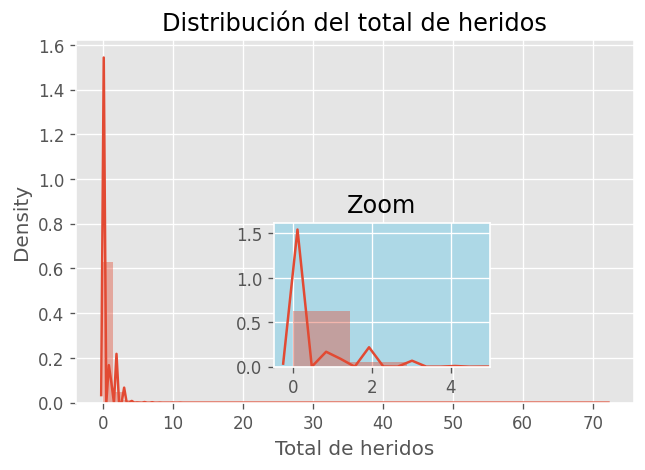

In [ ]:
fig, ax = plt.subplots(dpi=120)
ax.set_title('Distribución del total de heridos')
# Primera grafica, distribucion del total de heridos
sns.distplot(df_siniestros['TOTAL_HERIDOS'], ax=ax)
ax.set_xlabel('Total de heridos')
ax_zoom = fig.add_axes([0.4, 0.2, 0.3, 0.3], facecolor='lightblue')
sns.distplot(df_siniestros['TOTAL_HERIDOS'], ax=ax_zoom)
ax_zoom.set_title('Zoom')
ax_zoom.set_xlim(-0.5, 5.0)
ax_zoom.set_xlabel('')
ax_zoom.set_ylabel('');

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


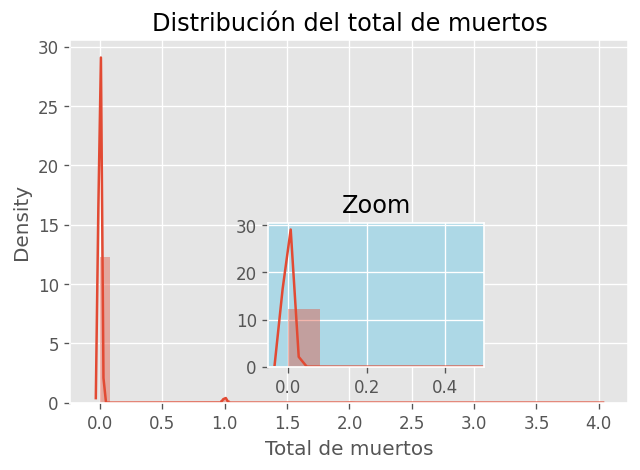

In [ ]:
fig, ax = plt.subplots(dpi=120)
ax.set_title('Distribución del total de muertos')
# Primera grafica, distribucion del total de heridos
sns.distplot(df_siniestros['TOTAL_MUERTOS'], ax=ax)
ax.set_xlabel('Total de muertos')
ax_zoom2 = fig.add_axes([0.4, 0.2, 0.3, 0.3], facecolor='lightblue')
sns.distplot(df_siniestros['TOTAL_MUERTOS'], ax=ax_zoom2)
ax_zoom2.set_title('Zoom')
ax_zoom2.set_xlim(-0.05, 0.5)
ax_zoom2.set_xlabel('')
ax_zoom2.set_ylabel('');

Lo gráfica anterior termina de afirmar nuestros cálculos, los datos del total de muertos y heridos no están muy dispersos y sus valores tienden a ser cercanos a la media.

Por último, miremos la asimetría, definida en pandas con el método `skew() `, nos dice hacia donde tiende la curva de la distribución.

In [ ]:
df_siniestros[['TOTAL_MUERTOS', 'TOTAL_HERIDOS']].skew()

TOTAL_MUERTOS     8.707379
TOTAL_HERIDOS    13.837383
dtype: float64

Este dato nos confirma algo que ya hemos visto en la grafica, las distribuciones tienen una asínmetría positiva. Otro dato que nos gustaría saber es la suma del total de muertos y heridos a través de los años. La calculamos en la siguiente celda.

In [ ]:
df_siniestros[['TOTAL_MUERTOS', 'TOTAL_HERIDOS']].sum()

TOTAL_MUERTOS     2695
TOTAL_HERIDOS    81715
dtype: int64

Por otra parte, debemos conocer los atributos categóricos de este dataframe, para saber qué valores pueden tomar, nos vamos a centrar en los atributos: **GRAVEDAD**, **CLASE**, **CHOQUE_CON**, **OBJETO_FIJO** y **DISENO_LUGAR** para ello haremos uso del método `unique()`

In [ ]:
print(f"GRAVEDAD: {df_siniestros['GRAVEDAD'].unique()}\n")
print(f"CLASE: {df_siniestros['CLASE'].unique()}\n")
print(f"OBJETO_FIJO: {df_siniestros['OBJETO_FIJO'].unique()}\n")
print(f"CHOQUE_CON: {df_siniestros['CHOQUE_CON'].unique()}\n")
print(f"DISENO_LUGAR: {df_siniestros['DISENO_LUGAR'].unique()}\n")


GRAVEDAD: ['Con Heridos' 'Solo Daños' 'Con Muertos']

CLASE: ['Choque' 'Volcamiento' 'Atropello' 'Otro' 'Caida de ocupante'
 'Autolesion' 'Incendio']

OBJETO_FIJO: [nan 'Muro' 'Inmueble' 'Vehiculo estacionado' 'Poste' 'Barandas' 'Arbol'
 'Valla, Señal' 'Otro' 'Tarima, Caseta' 'Semaforo' 'Hidrante']

CHOQUE_CON: ['Vehiculo' nan 'Objeto Fijo' 'Tren' 'Semoviente']

DISENO_LUGAR: ['Interseccion' 'Tramo de Via' 'Paso elevado' 'Lote o predio'
 'Paso inferior' 'Puente' 'Paso a nivel' 'Glorieta' 'Cicloruta'
 'Via peatonal' 'Ponton' 'Tunel' 'Via troncal']



Con base en los procesos realizados anteriormente, podemos caracterizar un poco mejor el conjunto de datos:

| Variable | Definición	| Valores | 
| --- | --- | --- |
| CODIGO_SINIESTRO | Identificador del accidente | |
| FECHA 	| Fecha en la que ocurrio el accidente | |
| HORA 	| Hora en la que ocurrio el accidente 	| |
| GRAVEDAD |	Gravedad del accidente 	| "Solo Daños", "Con Heridos" o "Con muertos" |
| CLASE |	Clase de accidente ocurrido 	| "Choque", "Atropello", "Caida de ocupante", "Volcamiento", "Otro", "Incendio", "Autolesion"|
| CHOQUE_CON |	Hace alución al objeto con el cual se produjo el choque 	| "Vehiculo", 'Objeto Fijo', "Semoviente" o "Tren"  |
| OBJETO_FIJO |	Hace alución a algún objeto fijo con el cual ocurrio el choque | "Vehiculo estacionado", "Poste", "Muro", "Inmueble", "Barandas", "Otro", "Valla, Señal", "Arbol", "Semaforo", "Tarima, Caseta", "Hidrante". |	
| DIRECCION 	| Dirección donde tuvo lugar el accidente | |	
| TOTAL_MUERTOS | Número de muertos totales del accidente | |
| TOTAL_HERIDOS | Número de heridos totales del accidente |	|
| LOCALIDAD |Localidad de Bogotá donde ocurrió el siniestro| |
| DISENO_LUGAR | Descripción del lugar donde ocurrio el accidente|	"Tramo de Via", "Interseccion", "Glorieta", "Lote o predio", "Paso elevado", "Paso inferior", "Puente", "Paso a nivel", "Cicloruta", "Via peatonal", "Tunel", "Ponton" y "Via troncal" |

Lo mismo hacemos para los otros dos Dataframes.

### **Dataframe `df_actores`**

Primero realizamos el vistazo inicial con el método `info()`

In [ ]:
df_actores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 374078 entries, 0 to 374077
Data columns (total 7 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   CODIGO_SINIESTRO  374078 non-null  int64  
 1   FECHA             374078 non-null  object 
 2   CONDICION         374078 non-null  object 
 3   ESTADO            374078 non-null  object 
 4   EDAD              367491 non-null  float64
 5   SEXO              374078 non-null  object 
 6   VEHICULO          352757 non-null  object 
dtypes: float64(1), int64(1), object(5)
memory usage: 20.0+ MB


Vemos que es un dataset mas grande que `df_accidentes`, esto tiene sentido ya que en un mismo accidente pueden verse implicadas varias personas, con el análisis exploratorio hecho anteriormente, vimos que en un solo accidente se vieron implicados 72 personas heridas. 

En total tenemos 374078 filas, con 6 columnas, de las cuales dos son variables numéricas, **CODIGO_SINIESTRO** y **EDAD**. El resto, son variables categóricas. También, podemos observar que las columnas **EDAD** y **VEHICULO** presentan valores nulos.

Ahora vamos a usar `describe()` para obtener las estadisticas mas comunes.

In [ ]:
df_actores[['EDAD']].describe()

,EDAD
count,367491.000000
mean,37.834722
std,14.261490
min,-2.000000
25%,27.000000
50%,36.000000
75%,47.000000
max,120.000000


Con lo anterior, podemos llegar a algunas conclusiones: Hay **algunos outliers como -2** (no pueden haber edades negativas), y tal vez 120, que debemos ir a revisar antes de algun proceso de correlación, por ejemplo. **El promedio de edades está en los 37 años aproximandamente**, la mitad de las personas que se vieron implicadas en accidentes de transito entre 2015 y 2019 tenian al rededor de 36 años, esto nos lo dice el Cuartil 2.

También podemos ver que la desviación estándar es mucho mayor a cero, lo que nos dice que **los datos están algo dispersos**, por último miremos la curtosis, para conocer el ancho de la curva o pico de las edades.

In [ ]:
df_actores['EDAD'].kurt()

0.715000341514263

La curtosis nos dio un valor levemente mayor a 0, lo que indica que **los datos NO están concentrados en la media**, tendremos una curva mas abierta, la curva debería formar ***casi*** una distribución normal. Si graficamos la distribución podemos entonces, darnos cuenta de nuestros cálculos.

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


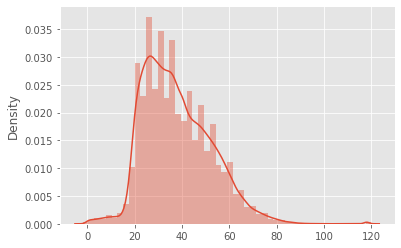

In [ ]:
sns.distplot(x=df_actores['EDAD'])

Ahora vamos a revisar en detalle los atributos categóricos, con el fin de averiguar que valores pueden tomar, para ello vamos a hacer uso de nuevo del método `unique()`. Vamos a ejecutar este metodo con los atributos categóricos **'CONDICION'**, **'ESTADO'** y **'SEXO'**

In [ ]:
print(f"CONDICION: {df_actores['CONDICION'].unique()}\n")
print(f"ESTADO: {df_actores['ESTADO'].unique()}\n")
print(f"SEXO: {df_actores['SEXO'].unique()}\n")

CONDICION: ['CONDUCTOR' 'PEATON' 'PASAJERO' 'MOTOCICLISTA' 'CICLISTA']

ESTADO: ['ILESO' 'HERIDO' 'SIN INFORMACION' 'MUERTO']

SEXO: ['MASCULINO' 'FEMENINO' 'SIN INFORMACION']



Ahora, queremos ver la cantidad de apariciones de los valores anteriormente mencionados, para ello hacemos uso del método `value_counts()`

In [ ]:
df_actores['CONDICION'].value_counts()

CONDUCTOR       273024
MOTOCICLISTA     45066
PASAJERO         24369
PEATON           21321
CICLISTA         10298
Name: CONDICION, dtype: int64

In [ ]:
df_actores['ESTADO'].value_counts()

ILESO              287582
HERIDO              81448
MUERTO               2697
SIN INFORMACION      2351
Name: ESTADO, dtype: int64

In [ ]:
df_actores['SEXO'].value_counts()

MASCULINO          308236
FEMENINO            57525
SIN INFORMACION      8317
Name: SEXO, dtype: int64

Con base en los procesos realizados anteriormente, podemos caracterizar mucho mejor el conjunto de datos:

| Variable | Definición	| Valores | 
| --- | --- | --- |
| CODIGO SINIESTRO | Codigo que idengtifica al siniestro|| |FECHA| Fecha en la cual se registró el sinisestro||
| CONDICION| Rol que cumple la persona en el accidente|'CONDUCTOR' 'PEATON' 'PASAJERO' 'MOTOCICLISTA' 'CICLISTA' |
| ESTADO | Estado de salud de la persona luego del accidente | 'ILESO' 'HERIDO' 'SIN INFORMACION' 'MUERTO' |
| EDAD | Edad de la persona implicada en el siniestro| |
| SEXO | Sexo de la persona implicada| 'MASCULINO' 'FEMENINO' 'SIN INFORMACION'|
| VEHICULO | Identificador del vehiculo | |

# **FASE 3: Preparación de los datos**

### **1. Limpieza de los datos**


Con base en el análisis exploratorio que se realizó en la etapa anterior, solamente vamos a tener en cuenta las edades de 0 en adelante, siendo cero los recién nacidos. Además, no vamos a tener en cuenta aquellos registros que no tenga información de sexo, se hace necesario para el cumplimiento de los objetivos poder caracterizar a las personas de acuerdo a esta variable para encontrar comportamientos de los hombres y mujeres en las vías más adelante.

In [ ]:
df_actores_limpio = df_actores[~(df_actores['SEXO'] == 'SIN INFORMACION') & (df_actores['EDAD'] >= 0)]
df_actores_limpio = df_actores_limpio[['CODIGO_SINIESTRO', 'EDAD', 'SEXO', 'CONDICION']]
df_actores_limpio.sample(5)

,CODIGO_SINIESTRO,EDAD,SEXO,CONDICION
93877,4445608,39.0,MASCULINO,CONDUCTOR
245047,10447085,36.0,MASCULINO,CONDUCTOR
267603,10457400,40.0,MASCULINO,CONDUCTOR
365412,10503234,19.0,MASCULINO,CONDUCTOR
221366,4505969,61.0,MASCULINO,CONDUCTOR


### **2. Preprocesamiento y transformación**

#### **Df_siniestros**

Vamos a realizar una serie de transformaciones al dataframe `df_siniestros`, con el fin de categorizar algunos datos de utilidad que estan organizados de forma continua. Primero, vamos a crear una columna con nombre **'MOMENTO_DEL_DIA'**, el cual va a guardar los valores de 'Mañana', 'Tarde' y 'Noche' dependiendo de la hora en la cual sucedió el siniestro.

Pro esto, primero concatenamos la columna **'FECHA'** con la columna **'HORA'**, asi:

In [ ]:
df_siniestros['FECHA'] = df_siniestros['FECHA'].astype(str) + ' ' + df_siniestros['HORA'].astype(str)

Posteriormente convertimos la columna a el tipo de dato `datetime`, para usar algunas utilidades que Pandas nos ofrece, como extraer horas, minutos, meses, entre otras. Para ello usamos la función `datetime` y establecemos el `format` correspondiente.

In [ ]:
df_siniestros['FECHA'] = pd.to_datetime(df_siniestros['FECHA'], format='%d/%m/%Y %H:%M:%S')

Ahora, podemos realizar la categorización usando la funcion `cut` de Pandas, el cual nos ofrece la oportunidad de construir un numero determinado de clases dada una serie de datos, que en nuestro caso es un listado de horas en formato 24h. Establecemos las clases  de la siguiente forma:

* Si `dt.hour` está en $(-1, 5]$ $\longrightarrow$ **'Madrugada'**
* Si `dt.hour` está en $(5, 8]$ $\longrightarrow$ **'Hora pico madrugada'**
* Si `dt.hour` está en $(8, 12]$ $\longrightarrow$ **'Mañana'**
* Si `dt.hour` está en $(12, 17]$ $\longrightarrow$ **'Tarde'**
* Si `dt.hour` está en $(17, 21]$ $\longrightarrow$ **'Hora pico noche'**
* Si `dt.hour` está en $(21, 24]$ $\longrightarrow$ **'Noche'**

In [ ]:
df_siniestros['MOMENTO_DEL_DIA'] = pd.cut(df_siniestros['FECHA'].dt.hour,  [-1, 5, 8, 12, 17, 21, 24], labels=['Madrugada', 'Hora pico madrugada', 'Mañana', 'Tarde', 'Hora pico noche', 'Noche']).astype(str)

In [ ]:
#df_siniestros['MOMENTO_DEL_DIA'] = pd.cut(df_siniestros['FECHA'].dt.hour,  [-1, 12, 17, 24], labels=['Mañana', 'Tarde', 'Noche']).astype(str)

Posteriormente a la categorizacion del momento del día en el cual ocurrió el siniestro, vamos a realizar una elección de las variables de interés de nuestro dataframe `df_siniestros`, como vimos en la _Fase 2: Entendimiento de los datos_, existen variables con valores nulos, los cuales son las columnas **'CHOQUE_CON'** y **'OBJETO_FIJO'**, de estas dos, **'OBJETO FIJO' **es la que mas valores nulos posee. En el analisis de la Fase 2, tambien nos dimos cuenta que **'CHOQUE_CON' **nos da la informacion de la entidad con la cual ocurrió el choque:

In [ ]:
df_siniestros['CHOQUE_CON'].value_counts()

Vehiculo       142122
Objeto Fijo      5514
Semoviente         73
Tren               28
Name: CHOQUE_CON, dtype: int64

Mientras que, **'OBJETO_FIJO'** nos da el detalle de el objeto fijo con el cual ocurrió el choque (e.g. poste, árbol)

In [ ]:
df_siniestros['OBJETO_FIJO'].value_counts()

Vehiculo estacionado    1454
Poste                   1320
Muro                    1039
Inmueble                 674
Barandas                 244
Otro                     221
Valla, Señal             183
Arbol                    182
Semaforo                 133
Tarima, Caseta            38
Hidrante                  26
Name: OBJETO_FIJO, dtype: int64

Para el presente estudio se ha decidido no tener en cuenta el detalle del objeto fijo, centrandonos solamente en '**CHOQUE_CON'**.

In [ ]:
df_siniestros_preprocesado = df_siniestros[['CODIGO_SINIESTRO', 'GRAVEDAD', 'LOCALIDAD', 'DISENO_LUGAR', 'CLASE', 'CHOQUE_CON', 'MOMENTO_DEL_DIA']]
df_siniestros_preprocesado.reset_index(drop=True)
df_siniestros_preprocesado.sample(5)

,CODIGO_SINIESTRO,GRAVEDAD,LOCALIDAD,DISENO_LUGAR,CLASE,CHOQUE_CON,MOMENTO_DEL_DIA
87761,4490627,Con Heridos,Usme,Tramo de Via,Choque,Vehiculo,Hora pico madrugada
131857,10465341,Con Heridos,Puente Aranda,Tramo de Via,Atropello,NaN,Hora pico madrugada
140854,10474471,Con Heridos,Engativá,Tramo de Via,Volcamiento,NaN,Hora pico noche
2409,4404438,Solo Daños,Fontibón,Tramo de Via,Choque,Objeto Fijo,Mañana
140790,10474462,Con Heridos,Suba,Interseccion,Choque,Vehiculo,Tarde


#### **Df_actores**

Para los actores vamos a realizar un preprocesamiento con el fin de obtener la cantidad de hombres y mujeres implicados en un accidente de transito, tambien, vamos a sacar un promedio general de la edad de ambos generos. Por último, vamos a tener en cuenta la columna **'CONDICION'**. Para esta ultima transformacion, vamos a crear 4 columnas nuevas haciendo alusion a los cuatro valores posibles que puede tomar este atributo: 'CONDUCTOR', 'MOTOCICLISTA', 'PEATON', 'CICLISTA'. Y vamos a colocar 1 donde se haya visto implicado alguno de estos roles y 0 en caso contrario.

In [ ]:
#Mirar una forma de hacerlo mas rapido
df_actores_preprocesado = df_actores_limpio
df_actores_preprocesado['CANTIDAD_HOMBRES'] = np.where(df_actores_preprocesado['SEXO'] == 'MASCULINO', 1, 0)
df_actores_preprocesado['CANTIDAD_MUJERES'] = np.where(df_actores_preprocesado['SEXO'] == 'FEMENINO', 1, 0)
df_actores_preprocesado['CATEGORIA_EDAD']= pd.cut(df_actores_preprocesado['EDAD'], [-1, 5, 11, 18, 26, 59, np.max(df_actores_preprocesado['EDAD'])], labels=['Infancia', 'Niñez', 'Adolescencia', 'Juventud', 'Adultez', 'Adulto Mayor'])
df_actores_preprocesado.drop(columns=['EDAD'], inplace=True)
df_actores_preprocesado['CATEGORIA_EDAD'] = df_actores_preprocesado.groupby('CODIGO_SINIESTRO')['CATEGORIA_EDAD'].transform(','.join)
for col in df_actores_preprocesado['CONDICION'].unique():
    df_actores_preprocesado[col] = np.where(df_actores_preprocesado['CONDICION'] == col, 1, 0)


In [ ]:
df_actores_preprocesado['CATEGORIA_EDAD'] = df_actores_preprocesado['CATEGORIA_EDAD'].transform(lambda s: ','.join(sorted(set(s.split(',')))))

In [ ]:
df_actores_preprocesado = df_actores_preprocesado.groupby(['CODIGO_SINIESTRO', 'CATEGORIA_EDAD']).sum().reset_index()

In [ ]:
df_actores_preprocesado.iloc[:,4:] = (df_actores_preprocesado.iloc[:,4:] > 0).astype(int)

In [ ]:
df_actores_preprocesado.head(5)

,CODIGO_SINIESTRO,CATEGORIA_EDAD,CANTIDAD_HOMBRES,CANTIDAD_MUJERES,CONDUCTOR,PEATON,PASAJERO,MOTOCICLISTA,CICLISTA
0,4401419,Adultez,1,1,1,0,1,0,0
1,4401420,"Adultez,Juventud",2,0,1,0,0,0,0
2,4401421,"Adolescencia,Adulto Mayor,Juventud",2,1,1,1,0,0,0
3,4401422,Adultez,2,0,1,0,0,0,1
4,4401423,"Adultez,Juventud",1,1,1,1,0,0,0


#### **X | Dataframe Final**
Finalmente, hacemos un `merge outer` para unir nuestros dos datasets pre-procesados anteriormente. Este dataset final será nuestra base de conocimiento para el entrenamiento.

In [ ]:
X = df_siniestros_preprocesado.merge(df_actores_preprocesado, on='CODIGO_SINIESTRO', how='inner')

Ahora vamos a obtener las etiquetas presentes en `X`. La columna `'GRAVEDAD' `es nuestra etiqueta, la cual almacena cual grave fue un accidente de tránsito. Vamos a realizar un mapeo de esta variable de esta forma:

* `'Con Muertos'`: Será la gravedad más alta, le daremos un puntaje de 3.

* `'Con Heridos'`: Será una puntuación intermedia, menor a la anterior. Le daremos un puntaje de 2.

* `'Solo Daños'`: Será la gravedad mas leve, le daremos un puntaje de 1,

In [ ]:
gravedad_numerico = {
    'Con Muertos': 3, # Cuando hay un accidente con muertos, tenemos el nivel mas alto de gravedad
    'Con Heridos': 2, # Con heridos tenemos el segundo nivel mas alto de gravedad
    'Solo Daños': 1 # Cuando solo hubo años, tenemos el nivel mas bajo de gravedad.
}
y = X['GRAVEDAD'].map(gravedad_numerico)
y.value_counts()

1    113770
2     56588
3      2602
Name: GRAVEDAD, dtype: int64

Luego de obtener nuestras tres categorias, debemos eliminar la columna **'GRAVEDAD'**, pues las etiquetas no deben estar en los datos fuente. Tambien vamos a eliminar la columna **'CODIGO_SINIESTRO'**, pues es solo un identificador del accidente y no nos otorga información valiosa para la predicción.

In [ ]:
X = X.drop(columns=['GRAVEDAD', 'CODIGO_SINIESTRO'])

In [ ]:
values = {
    'CHOQUE_CON': 'SIN_INFORMACION',
}
X.fillna(value=values, inplace=True)

In [ ]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 172960 entries, 0 to 172959
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   LOCALIDAD         172960 non-null  object
 1   DISENO_LUGAR      172960 non-null  object
 2   CLASE             172960 non-null  object
 3   CHOQUE_CON        172960 non-null  object
 4   MOMENTO_DEL_DIA   172960 non-null  object
 5   CATEGORIA_EDAD    172960 non-null  object
 6   CANTIDAD_HOMBRES  172960 non-null  int64 
 7   CANTIDAD_MUJERES  172960 non-null  int64 
 8   CONDUCTOR         172960 non-null  int64 
 9   PEATON            172960 non-null  int64 
 10  PASAJERO          172960 non-null  int64 
 11  MOTOCICLISTA      172960 non-null  int64 
 12  CICLISTA          172960 non-null  int64 
dtypes: int64(7), object(6)
memory usage: 18.5+ MB


Como vemos, aun tenemos variables en forma de cadenas de texto, vamos a realizar un preprocesamiento usando `OneHotEncoder()` de la siguiente forma.

In [ ]:
X.head()

,LOCALIDAD,DISENO_LUGAR,CLASE,CHOQUE_CON,MOMENTO_DEL_DIA,CATEGORIA_EDAD,CANTIDAD_HOMBRES,CANTIDAD_MUJERES,CONDUCTOR,PEATON,PASAJERO,MOTOCICLISTA,CICLISTA
0,Engativá,Interseccion,Choque,Vehiculo,Mañana,"Adultez,Juventud",1,1,1,1,0,0,0
1,Suba,Tramo de Via,Choque,Vehiculo,Tarde,Adultez,2,1,1,0,0,1,0
2,Ciudad Bolívar,Tramo de Via,Volcamiento,SIN_INFORMACION,Hora pico madrugada,Adultez,1,0,0,0,0,1,0
3,Chapinero,Tramo de Via,Choque,Vehiculo,Hora pico noche,Juventud,2,0,1,0,0,0,0
4,Ciudad Bolívar,Tramo de Via,Choque,Vehiculo,Mañana,"Adultez,Juventud",2,0,1,0,0,1,0


#### **Preprocesamiento usando `OneHotEncoder()`**

Vamos a realizar la transformacion de los datos categoricos usando `OneHotEncoder`, pars esto establecemops una lista con el nombre de las categorias presente en nuestro dataframe. El parametro `remainder` de `ColumnTransformer` nos permite establecer qué pasar con aquellas columnas a las cuales no se les hará el preprocesamiento, estableciendo su valos a `passthrough` dejamos las columnas con el mismo valor, esto se hace para las columnas numericas: `PROMEDIO_EDAD`, `CANTIDAD_NOMBRES` y `CANTIDAD_MUJERES`.

In [ ]:
categorias = ['LOCALIDAD', 'DISENO_LUGAR', 'CLASE', 'CHOQUE_CON', 'MOMENTO_DEL_DIA', 'CATEGORIA_EDAD']
tf = ColumnTransformer([('onehot', OneHotEncoder(), categorias)], remainder='passthrough')

In [ ]:
X_preprocessed = tf.fit_transform(X)

Luego de haber realizado la transformación, inspeccionamos el numero de características finales, viendo que como era de esperarse, aumentaron.

In [ ]:
print(f"# de caracteristicas de los datos originales {X.shape} \n# de caractersticas del preprocesamiento: {X_preprocessed.shape}")

# de caracteristicas de los datos originales (172960, 13) 
# de caractersticas del preprocesamiento: (172960, 118)


In [ ]:
print(X_preprocessed.todense()[1])

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
  0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 1. 1. 0. 0. 1. 0.]]


#### **Interpretación del preprocesamiento final**

Vamos a interpretar los datos preprocesados, en la celda inferior se muestra un registro de nuestros dastos preprocesados. Haciendo uso del método `get_feature_names()` nos damos cuenta del orden de los datos presentes en el registro. 

In [ ]:
onehot_categories = tf.named_transformers_['onehot'].get_feature_names()
onehot_categories

array(['x0_Antonio Nariño', 'x0_Barrios Unidos', 'x0_Bosa',
       'x0_Chapinero', 'x0_Ciudad Bolívar', 'x0_Engativá', 'x0_Fontibón',
       'x0_Kennedy', 'x0_La Candelaria', 'x0_Los Mártires',
       'x0_Puente Aranda', 'x0_Rafael Uribe Uribe', 'x0_San Cristóbal',
       'x0_Santa Fe', 'x0_Suba', 'x0_Sumapaz', 'x0_Teusaquillo',
       'x0_Tunjuelito', 'x0_Usaquén', 'x0_Usme', 'x1_Cicloruta',
       'x1_Glorieta', 'x1_Interseccion', 'x1_Lote o predio',
       'x1_Paso a nivel', 'x1_Paso elevado', 'x1_Paso inferior',
       'x1_Ponton', 'x1_Puente', 'x1_Tramo de Via', 'x1_Tunel',
       'x1_Via peatonal', 'x1_Via troncal', 'x2_Atropello',
       'x2_Autolesion', 'x2_Caida de ocupante', 'x2_Choque',
       'x2_Incendio', 'x2_Otro', 'x2_Volcamiento', 'x3_Objeto Fijo',
       'x3_SIN_INFORMACION', 'x3_Semoviente', 'x3_Tren', 'x3_Vehiculo',
       'x4_Hora pico madrugada', 'x4_Hora pico noche', 'x4_Madrugada',
       'x4_Mañana', 'x4_Noche', 'x4_Tarde', 'x5_Adolescencia',
       'x5_Adolesc

Con base en la celda anterior, donde obtuvimos el orden de los elementos, los primeros 20 datos nos da la informacion de la localidad donde ocurrio el siniestro, en el siguiente órden:

```python3
['Antonio Nariño', 'Barrios Unidos', 'Bosa', 
'Chapinero', 'Ciudad Bolívar', 'Engativá', 'Fontibón',
'Kennedy', 'La Candelaria', 'Los Mártires',
'Puente Aranda', 'Rafael Uribe Uribe', 'San Cristóbal',
'Santa Fe', 'Suba', 'Sumapaz', 'Teusaquillo',
'Tunjuelito', 'Usaquén', 'Usme']
```

Las siguientes 13 posiciones nos habla del diseño del lugar donde ocurrio el accidente, en este orden:

```python3
['Cicloruta', 'Glorieta', 'Interseccion', 'Lote o predio',
'Paso a nivel', 'Paso elevado', 'Paso inferior','Ponton',
'Puente', 'Tramo de Via', 'Tunel', 'Via peatonal', 'Via troncal'
]
```

Adicionalmente, las siguientes 7 posiciones nos da la informacion de la clase de accidente ocurrido, en el siguiente orden:

```python3
['Atropello', 'Autolesion', 'Caida de ocupante', 
'Choque','Incendio', 'Otro', 'Volcamiento']
```

Las 5 caractierísticas siguientes nos da la informacion del objeto con el cual se produjo el choque. Observemos que que si el accidente no fue de clase Choque, tenemos una categoria 'SIN INFORMACION'. El orden es como sigue:

```python3
['Objeto Fijo', 'SIN_INFORMACION', 'Semoviente', 
'Tren', 'Vehiculo']
```
Las siguientes 6 caracteristicas presentes en nuesdtros datos preprocesados, nos da la informacion del momento en el cual ocurrió el accidente, de la siguiente manera:

```python3
['Hora pico madrugada', 'Hora pico noche', 
'Madrugada', 'Mañana', 'Noche', 'Tarde']
```

Las siguientes 60 características corresponden a las categorías creadas para las edades de los actores involucrados:

```python
[
       'Adolescencia',
       'Adolescencia,Adultez', 'Adolescencia,Adultez,Adulto Mayor',
       'Adolescencia,Adultez,Adulto Mayor,Infancia',
       'Adolescencia,Adultez,Adulto Mayor,Infancia,Juventud',
       'Adolescencia,Adultez,Adulto Mayor,Infancia,Juventud,Niñez',
       'Adolescencia,Adultez,Adulto Mayor,Infancia,Niñez',
       'Adolescencia,Adultez,Adulto Mayor,Juventud',
       'Adolescencia,Adultez,Adulto Mayor,Juventud,Niñez',
       'Adolescencia,Adultez,Adulto Mayor,Niñez',
       'Adolescencia,Adultez,Infancia',
       'Adolescencia,Adultez,Infancia,Juventud',
       'Adolescencia,Adultez,Infancia,Juventud,Niñez',
       'Adolescencia,Adultez,Infancia,Niñez',
       'Adolescencia,Adultez,Juventud',
       'Adolescencia,Adultez,Juventud,Niñez',
       'Adolescencia,Adultez,Niñez', 'Adolescencia,Adulto Mayor',
       'Adolescencia,Adulto Mayor,Infancia',
       'Adolescencia,Adulto Mayor,Infancia,Juventud',
       'Adolescencia,Adulto Mayor,Infancia,Niñez',
       'Adolescencia,Adulto Mayor,Juventud',
       'Adolescencia,Adulto Mayor,Niñez', 'Adolescencia,Infancia',
       'Adolescencia,Infancia,Juventud',
       'Adolescencia,Infancia,Juventud,Niñez',
       'Adolescencia,Infancia,Niñez', 'Adolescencia,Juventud',
       'Adolescencia,Juventud,Niñez', 'Adolescencia,Niñez',
       'Adultez', 'Adultez,Adulto Mayor',
       'Adultez,Adulto Mayor,Infancia',
       'Adultez,Adulto Mayor,Infancia,Juventud',
       'Adultez,Adulto Mayor,Infancia,Juventud,Niñez',
       'Adultez,Adulto Mayor,Infancia,Niñez',
       'Adultez,Adulto Mayor,Juventud',
       'Adultez,Adulto Mayor,Juventud,Niñez',
       'Adultez,Adulto Mayor,Niñez', 'Adultez,Infancia',
       'Adultez,Infancia,Juventud',
       'Adultez,Infancia,Juventud,Niñez', 'Adultez,Infancia,Niñez',
       'Adultez,Juventud', 'Adultez,Juventud,Niñez',
       'Adultez,Niñez', 'Adulto Mayor', 'Adulto Mayor,Infancia',
       'Adulto Mayor,Infancia,Juventud',
       'Adulto Mayor,Infancia,Niñez', 'Adulto Mayor,Juventud',
       'Adulto Mayor,Juventud,Niñez', 'Adulto Mayor,Niñez',
       'Infancia', 'Infancia,Juventud',
       'Infancia,Juventud,Niñez', 'Infancia,Niñez', 'Juventud',
       'Juventud,Niñez', 'Niñez'
]
```

Los últimos 7 elementos del registro, corresponden a las siguientes columnas de los datos originales `X`, en el mismo orden:

```python3
['CANTIDAD_HOMBRES', 'CANTIDAD_MUJERES', 'CONDUCTOR', 'PEATON', 'PASAJERO', 'MOTOCICLISTA', 'CICLISTA']
```

Entonces, volvamos a traer a colación nuestro registro inicial para interpretarlo:

In [ ]:
print(X_preprocessed.todense()[1])

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
  0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 1. 1. 0. 0. 1. 0.]]


En el ejemplo anterior, podemos sacar la siguiente informacion: El siniestro ocurrió en la localidad de **Suba**, especificamente en un **Tramo de vía**. Sucedió un **Choque** con un **Vehículo** en horas de la **Tarde**. El promedio de **Edad** en este accidente fue de 31 años, estuvieron implicados 3 personas; 2 hombres y una mujer, estos cumplian el rol de **Conductor** de automovil y  **Motociclista**. La **Edad** de las personas implicadas está entre los 27 a los 59 años (Adultez).

# **FASE 4: Modelamiento**

## **1. Elección del modelo** 

Luego de haber explorado y preparado los datos que vamos a estudiar, vamos a realizar la elección del modelo de aprendizaje computacional que más se acerque al problema que queremos solucionar. Como se mencionó anteriormente, uno de los objetivos es predecir la gravedad de un accidente de acuerdo a sus caracteristicas. Nuestro dataset `df_siniestros` dispone de la caracteristica **'GRAVEDAD'** la cual puede ser: 'Solo daños', 'Con Heridos' y 'Con Muertos'. Podemos encarar este problema utilizando un **modelo de aprendizaje supervesidado**, ya que disponemos de las etiquetas. En el inciso anterior, realizamos un preporcesamiento y obtencion de nuestras etiquetas.

Entre todos los modelos de aprendizaje supervisado, vamos a elegir como primera aproximacion un arbol de desicion, debido a la cantidad de atributos categoricos que tenemos en nuestros datos, es una buena idea usar un modelo de este tipo.

Primero revisemos nuestros datos y etiquetas:

In [ ]:
print(f"\nFilas y columnas de la fuente de datos: {X_preprocessed.shape}\nEtiquetas: {y.shape} -> con los valores {y.unique()}")


Filas y columnas de la fuente de datos: (172960, 118)
Etiquetas: (172960,) -> con los valores [2 1 3]


Antes de empezar con la construcción del calsificador, vamos a separar nuestros datos dejando un 70% para entrenamiento y un 30% para pruebas.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    X_preprocessed, y, test_size=0.3, random_state=7
)

### **Arbol de desición con `DesicionTreeClassifier`**

Ahora vamos construir el árbol de desicion usando `DesicionTreeClasifier`. No vamos a especificar el hiperparámetro de profundidad máxima `max_depth`, vamos a dejar que el modelo lo "descubra" por si solo. Mas adelante en la fase de Evaluacion, vamos a experimentar con diferentes niveles de profundidad y averiguaremos cual es el óptimo calculado por el modelo.

In [ ]:
clasificador = DecisionTreeClassifier(random_state=7)
clasificador.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=7, splitter='best')

In [ ]:
print(f'Error: {1 - clasificador.score(X_train, y_train)}')

Error: 0.06282212237346374


Con el calculo del error hecho en la celda anterior, parece ser que hay sobre ajuste. El error es muy cercano a cero, el árbol practicamente a memorizado los datos.

Usando la function `export_grphviz` podemos observar nuestro arbol de manera grafica, es un arbol bastante grande como podemos ver:

In [ ]:
from IPython.display import SVG
graphviz_data = export_graphviz(clasificador, 
                                out_file=None, 
                                #feature_names=iris.feature_names,  
                                #class_names=iris.target_names,  
                                filled=True, rounded=True,  
                                special_characters=True)  

graph = graphviz.Source(graphviz_data)
SVG(graph.pipe(format='svg'))

Es un poco complejo ver este arbol tan grande de la forma anterior, el siguiente codigo es usado para exportar la imagen a formato PNG.

In [ ]:
graph = graphviz.Source(export_graphviz(clasificador, out_file=None))
graph.format = 'png'
graph.render('accidentes_tree',view=True)

# **FASE 5: Evaluacion**



### **Evaluación de la complejidad del Arbol construido con `DesicionTreeClassifier`**

Vamos ahora a evaluar cuan complejo es el arbol creado en la fase de modelamiento, evaluando el nivel máximo de complejidad alcanzado para dar una respuesta correcta. Se van a explorar distintos numeros de profundidad máxima y posteriormente graficaremos el Error arrojado vs Profundiad máxima.

* `profundidades_maximas = ` $[4, 8, 12, 16, 20 ... 48, 52]$

In [ ]:
profundidades_maximas = np.arange(4, 54, 4) # Profundidades maximas de 4 en 4 hasta 52.
error_entrenamiento = [] #Arreglo par almacenar los errores de entranamiento
error_general = [] #Arreglo para almacenar los errores con los datos de prueba.

for profundidad in profundidades_maximas:
  clasificador_accidentes = DecisionTreeClassifier(max_depth=profundidad)
  clasificador_accidentes.fit(X_train, y_train)
  error_entrenamiento.append(1 - clasificador_accidentes.score(X_train, y_train))
  error_general.append(1 - clasificador_accidentes.score(X_test, y_test))

Posteriormente graficamos para poder interpretar los resultados.

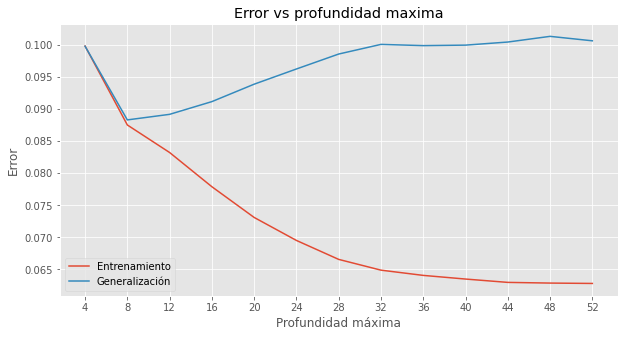

In [ ]:
plt.figure(figsize=(10, 5))

plt.title('Error vs profundidad maxima')
plt.plot(profundidades_maximas, error_entrenamiento, label="Entrenamiento")
plt.plot(profundidades_maximas, error_general, label="Generalización")
plt.xticks(profundidades_maximas)
plt.xlabel("Profundidad máxima"); plt.ylabel("Error");
plt.legend();

En la grafica anterior se puede observar que el modelo encuentra el punto de balance con una profundidad de 44 aproximadamente. En ese punto el modelo se estabiliza y el error es el más bajo, de 0.065 $\approx$ 6%. Y para el error de generalizacion, es decir, las pruebas con los datos de test, tenemos un error de 0.10 $\approx$ 10%.

Podemos entonces concluir que usando este modelo entrenado, tenemos una confiabilidad del 90% en las predicciones de letalidad en los accidentes de tránsito de la ciudad de Bogotá.

### **Taza de predicciones acertada por categoría**

Usando una matriz de confusión queremos averiguar la proporción de casos acertados por categoria para nuestro modelo. Primero, vamos a realizar predicciones usando los datos de prueba `X_test`.

In [ ]:
y_predict = clasificador.predict(X_test)

Ahora usando la función `confusion_matrix()` de Scikit-Learn, podemos armar una matriz de confusion con los datos verdaderos vs los datos predichos por el modelo.

In [ ]:
matriz_confusion = confusion_matrix(y_test, y_predict)
print(matriz_confusion)

[[32430  1720    22]
 [ 2524 14154   266]
 [   92   603    77]]


Utilizamos un mapa de calor para ver graficamente la matriz anterior, además realizamos una normalizacion para obtener los porcentajes de cada uno.

Normalized confusion matrix
[[9.49022592e+01 5.03336065e+00 6.43801943e-02]
 [1.48961284e+01 8.35339943e+01 1.56987724e+00]
 [1.19170984e+01 7.81088083e+01 9.97409326e+00]]


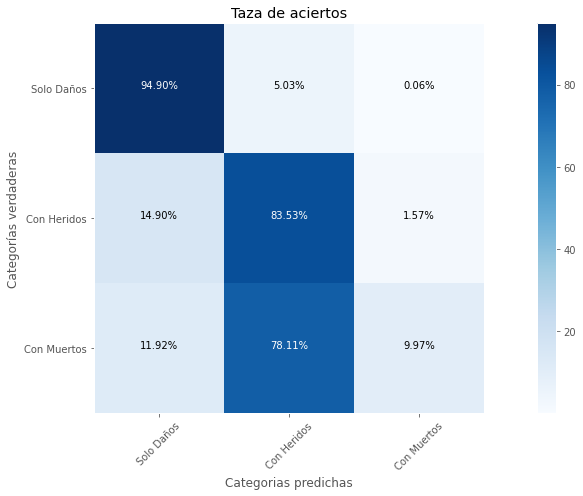

In [ ]:
plt.figure(figsize=(15, 7))
plot_confusion_matrix(matriz_confusion, classes=['Solo Daños', 'Con Heridos', 'Con Muertos'], normalize=True,
                      title='Taza de aciertos')

El mapa de calor anterior nos permite sacar información impotante. El modelo se comporta muy bien en cuanto a predecir accidentes en donde solo hubieron daños (categoría 3), un 94.9% de las veces atina al resultado correcto. Para los accidentes donde hubieron heridos (categoría 2), tenemos un 83.53% de efectividad. Finalmente vemos que el modelo es realmente malo en cuanto a predecir accidentes donde hubieron muertos, solo el 9.97% de las veces da en el blanco con esta categoría, clasificando la mayoría en la categoría 2.



### **Importancia de las variables**

Por último vamos a averiguar la importancia de las variables dentro del arbol. Para ello aramamos un dataframe en pandas con las caracteristicas usadas por el árbol con los correspondientes valores. Tambien calculamos el porcentaje de importancia de cada variable y lo asignamos a la columna  `PORCENTAJE DE IMPORTANCIA`

In [ ]:
df_variables_importantes = pd.DataFrame(
    data=clasificador.feature_importances_,
    index=np.append(onehot_categories, np.array(['CANTIDAD_HOMBRES', 'CANTIDAD_MUJERES', 'CONDUCTOR', 'PEATON', 'PASAJERO', 'MOTOCICLISTA', 'CICLISTA'])),
    columns=['VALUES']
)
df_variables_importantes['PORCENTAJE DE IMPORTANCIA'] = np.round(df_variables_importantes['VALUES'] * 100, 1).astype(str) + '%'

Una vez tenemos el dataframe construido, miremos el top 10 de las variables que más aportan a nuestro arbol de clasificacion. Para ello organizamos las variables por su valor poniendo de primero las mejor rankeadas.

In [ ]:
df_variables_importantes.sort_values(by='VALUES', ascending=False)[:10]

,VALUES,PORCENTAJE DE IMPORTANCIA
x2_Choque,0.349382,34.9%
MOTOCICLISTA,0.224038,22.4%
PASAJERO,0.156858,15.7%
CICLISTA,0.128660,12.9%
PEATON,0.014624,1.5%
CONDUCTOR,0.014361,1.4%
CANTIDAD_HOMBRES,0.007516,0.8%
x1_Interseccion,0.007434,0.7%
CANTIDAD_MUJERES,0.005704,0.6%
x5_Adultez,0.005056,0.5%


Vemos que la variable `x2_Choque` es la más importante en el arbol de desicion con un 34.9% de importancia, luego vienen las caracteristicas `MOTOCICLISTA` con un 22.4%, `PASAJERO`, `CICLISTA` y `PEATON`.

Tambien vamos a mirar el top 20 de las peores variables en importancia. Es decir, aquellas que no ofrecen "conocimiento" al arbol para ayudar a predecir.

In [ ]:
df_variables_importantes.sort_values(by='VALUES', ascending=False)[-20:]

,VALUES,PORCENTAJE DE IMPORTANCIA
x0_Sumapaz,0.0,0.0%
"x5_Adolescencia,Adultez,Adulto Mayor,Infancia,Juventud",0.0,0.0%
"x5_Adolescencia,Adultez,Adulto Mayor,Infancia",0.0,0.0%
"x5_Adolescencia,Adultez,Adulto Mayor,Infancia,Juventud,Niñez",0.0,0.0%
"x5_Adolescencia,Infancia,Niñez",0.0,0.0%
"x5_Adolescencia,Adultez,Infancia,Niñez",0.0,0.0%
"x5_Adulto Mayor,Infancia,Niñez",0.0,0.0%
"x5_Adolescencia,Adultez,Niñez",0.0,0.0%
"x5_Adolescencia,Adulto Mayor,Infancia",0.0,0.0%
"x5_Adolescencia,Adulto Mayor,Infancia,Juventud",0.0,0.0%


Vemos que en su mayoria, las variables `x5_*` no tienen nada de relevancia para el árbol construido, un trabajo futuro podría ser re-evaluar el preprocesamiento realizado con OneHotEncoder para la columna **Edad**, explorar otros tipos de transformadores para poder discretizarla de una mejor forma o quizá, obtener el promedio de edad de los accidentes.

## **Conclusiones**

* Con el modelo propuesto, podemos realizar predicciones de letalidad de accidentes con un error del 6% y un accuracy del 94%.

* El modelo construido funciona muy bien para predecir accidentes en la categoría 1 (Solo Daños) y categoría 2 (Con Heridos), pero deja mucho que desear para predecir los de categoría 3 (Con Muertos).

* Los aspectos más importantes a tener en cuenta para predecir la letalidad de los accidentes son: Choque (Si el accidente fue de este tipo), Moticilista, Pasajero, Peaton y Ciclista.

## **Créditos:**
* **_Autor_:** _Carlos Andrés Moreno Vélez_
_https://carmoreno.com.co_